In [1]:
import sys
dir_repo = '../../../'
sys.path.append(dir_repo)

from galaxyZooNet.utils import get_config_from_yaml
from galaxyZooNet.dcgan_generator import DCGAN_Generator

In [2]:
#! rm -rf /home/hhg/Research/galaxyClassify/repo/galaxyZooNet/experiment/dcgan/run0

In [3]:
config = get_config_from_yaml(dir_repo+'configs/dcgan_run0.yaml')
generator = DCGAN_Generator(config=config)


------ Parameters ------

exp_name : run0
cuda : True
ngpu : 1
gpu_device : 0
workers : 2
dir_image : /home/hhg/Research/galaxyClassify/catalog/galaxyZoo_kaggle/gz2_images/images
file_csv : /home/hhg/Research/galaxyClassify/catalog/galaxyZoo/zoo2/gz2_all_v2.csv
label_tag : label_8
num_classes : 8
class_weights : [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
seed : 3
norm_mean : [0.094, 0.0815, 0.063]
norm_std : [0.1303, 0.11, 0.0913]
crop_size : 224
input_size : 64
n_channel : 3
n_zlatent : 50
n_filter_g : 64
n_filter_d : 64
num_epochs : 100
batch_size : 64
lr_g : 0.0002
lr_d : 0.0002
beta1 : 0.5
beta2 : 0.999
dir_output : /home/hhg/Research/galaxyClassify/repo/galaxyZooNet/experiment/dcgan
nrow : 8

------ Prepare Data ------

Number of training galaxies: 155951 (2437 batches)

------ Build Model ------

Number of trainable parameters
Generator  : 3167104
Discriminator  : 3167104


In [3]:
generator.train()


------ Create experiment directory ------

Training information will be stored at :
 	 /home/hhg/Research/galaxyClassify/repo/galaxyZooNet/experiment/dcgan/run0

[1/100 epoch] [1 iter]	 loss_D: 1.367 	 loss_G: 4.082	 D(x):0.551 	 D(G(z)): 0.433 / 0.025
[1/100 epoch] [501 iter]	 loss_D: 0.012 	 loss_G: 6.133	 D(x):0.995 	 D(G(z)): 0.007 / 0.003
[1/100 epoch] [1001 iter]	 loss_D: 0.353 	 loss_G: 6.340	 D(x):0.744 	 D(G(z)): 0.002 / 0.002
[1/100 epoch] [1501 iter]	 loss_D: 0.007 	 loss_G: 14.714	 D(x):0.993 	 D(G(z)): 0.000 / 0.000
[1/100 epoch] [2001 iter]	 loss_D: 0.001 	 loss_G: 7.371	 D(x):1.000 	 D(G(z)): 0.001 / 0.001
	Training at epoch-0 | avg. netD loss: 0.272 | avg. netG loss 6.066
	Run time per epoch: 2m 14s
[2/100 epoch] [2438 iter]	 loss_D: 0.019 	 loss_G: 5.228	 D(x):0.986 	 D(G(z)): 0.003 / 0.006
[2/100 epoch] [2938 iter]	 loss_D: 0.687 	 loss_G: 0.896	 D(x):0.684 	 D(G(z)): 0.082 / 0.444
[2/100 epoch] [3438 iter]	 loss_D: 0.002 	 loss_G: 7.358	 D(x):0.999 	 D(G(z)): 0.001 

[15/100 epoch] [34619 iter]	 loss_D: 0.000 	 loss_G: 60.302	 D(x):1.000 	 D(G(z)): 0.000 / 0.000
[15/100 epoch] [35119 iter]	 loss_D: 0.000 	 loss_G: 59.241	 D(x):1.000 	 D(G(z)): 0.000 / 0.000
[15/100 epoch] [35619 iter]	 loss_D: 0.000 	 loss_G: 58.388	 D(x):1.000 	 D(G(z)): 0.000 / 0.000
[15/100 epoch] [36119 iter]	 loss_D: 0.000 	 loss_G: 58.239	 D(x):1.000 	 D(G(z)): 0.000 / 0.000
	Training at epoch-14 | avg. netD loss: 0.007 | avg. netG loss 50.820
	Run time per epoch: 2m 15s
[16/100 epoch] [36556 iter]	 loss_D: 0.000 	 loss_G: 58.310	 D(x):1.000 	 D(G(z)): 0.000 / 0.000
[16/100 epoch] [37056 iter]	 loss_D: 0.000 	 loss_G: 58.245	 D(x):1.000 	 D(G(z)): 0.000 / 0.000
[16/100 epoch] [37556 iter]	 loss_D: 0.000 	 loss_G: 58.229	 D(x):1.000 	 D(G(z)): 0.000 / 0.000
[16/100 epoch] [38056 iter]	 loss_D: 0.000 	 loss_G: 58.216	 D(x):1.000 	 D(G(z)): 0.000 / 0.000
[16/100 epoch] [38556 iter]	 loss_D: 0.000 	 loss_G: 58.204	 D(x):1.000 	 D(G(z)): 0.000 / 0.000
	Training at epoch-15 | avg. 

KeyboardInterrupt: 

### Training losses

In [4]:
import matplotlib.pyplot as plt
import pickle
import numpy as np

import matplotlib.animation as animation
from IPython.display import HTML

%matplotlib inline
%config InlineBackend.figure_format='retina'

In [5]:
print(f'open file : {generator.file_trainInfo}')
trainInfo = pickle.load(file = open(generator.file_trainInfo, 'rb'))
trainInfo.keys()

open file : /home/hhg/Research/galaxyClassify/repo/galaxyZooNet/experiment/dcgan/run0/trainInfo.pkl


dict_keys(['loss_G', 'loss_D', 'epoch_loss_G', 'epoch_loss_D', 'img_list', 'lr'])

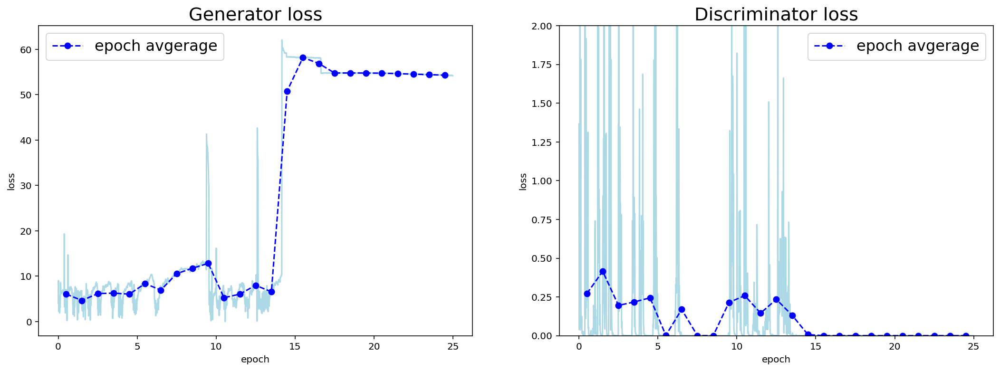

In [6]:
freq = 30

# ------

fig, ax = plt.subplots(1, 2, figsize=(18, 6))
plt.rc('font', size=16)

iter_tick = np.array(range(len(trainInfo['loss_G'])))/len(generator.dataloader)

epoch_tick = np.array(range(len(trainInfo['epoch_loss_G'])))+0.5

ax[0].plot(iter_tick[::freq], trainInfo['loss_G'][::freq], color='lightblue')
ax[0].plot(epoch_tick, trainInfo['epoch_loss_G'], 'o--', label='epoch avgerage', color='b')

ax[1].plot(iter_tick[::freq], trainInfo['loss_D'][::freq], color='lightblue')
ax[1].plot(epoch_tick, trainInfo['epoch_loss_D'], 'o--', label='epoch avgerage', color='b')

ax[0].set_title(f'Generator loss')
ax[1].set_title(f'Discriminator loss')

ax[1].set_ylim([0, 2])

for i in range(2):
    ax[i].set_ylabel('loss')
    ax[i].set_xlabel('epoch')
    ax[i].legend()

### generator galaxies

In [10]:
len(trainInfo['img_list'])

125

Animation size has reached 21248292 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


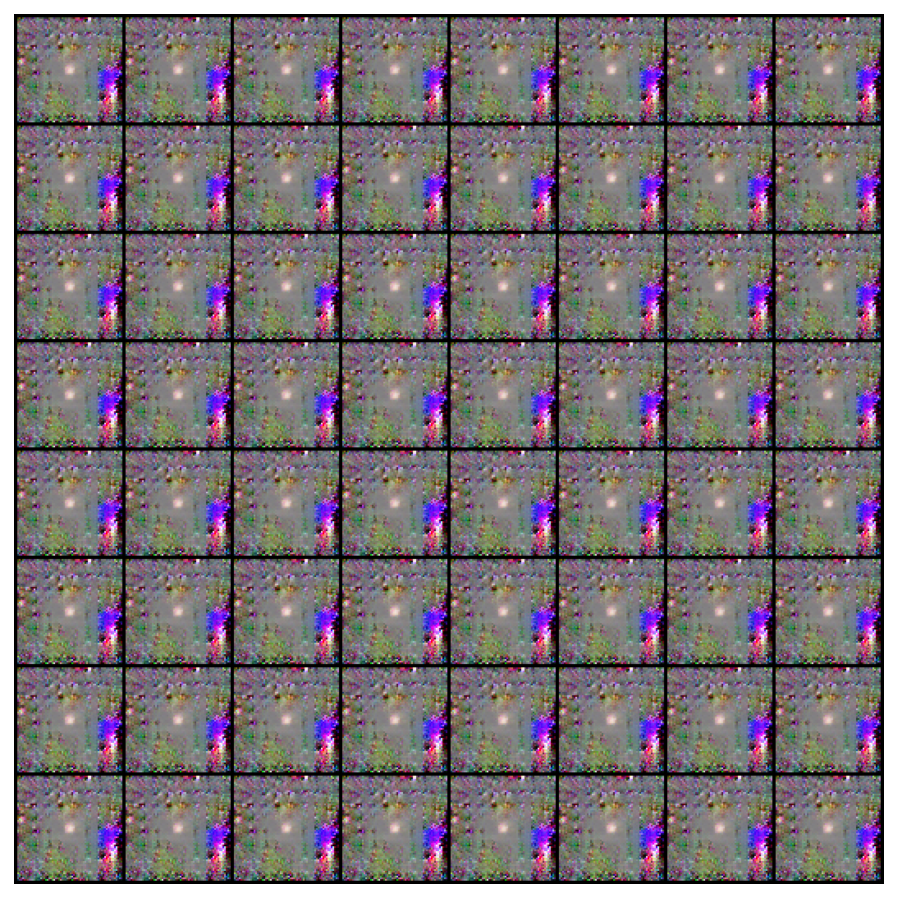

In [7]:
step_jump = 1

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in trainInfo['img_list'][::step_jump]]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

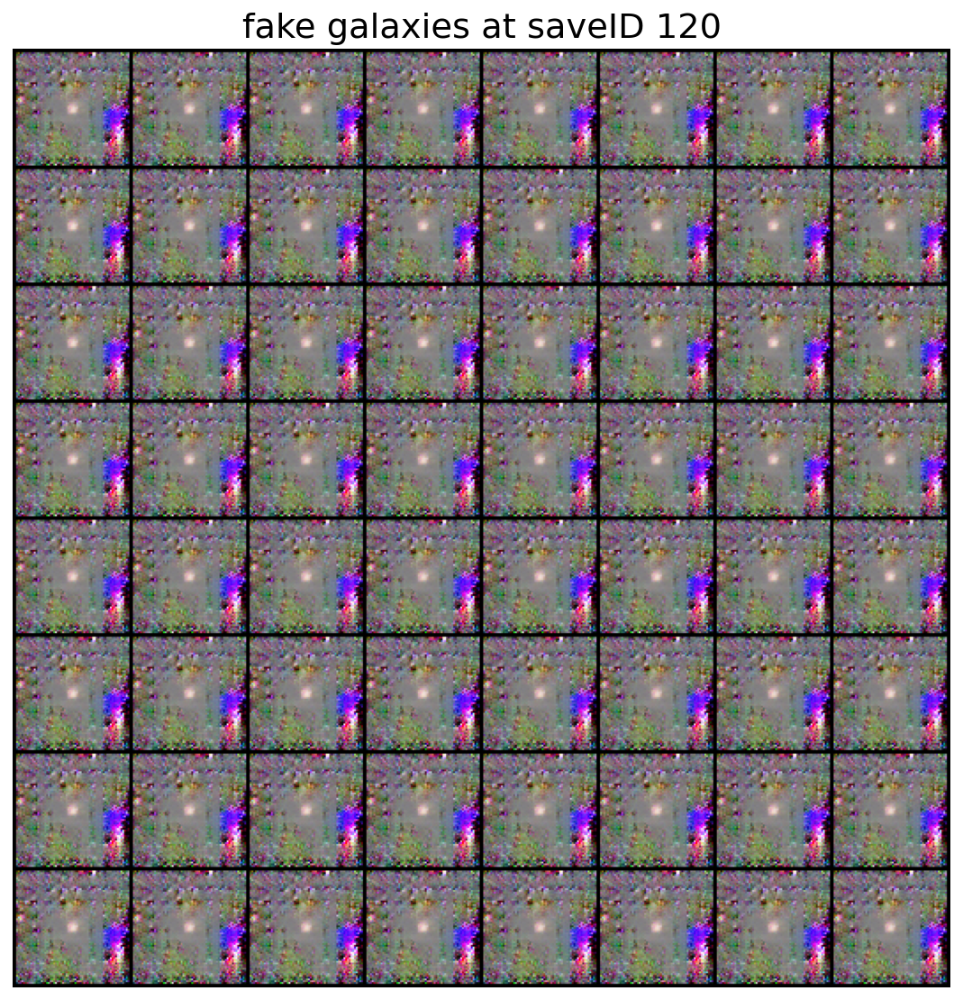

In [17]:
saveID = 120

fig = plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f'fake galaxies at saveID {saveID}')
plt.imshow(np.transpose(trainInfo['img_list'][saveID],(1,2,0)))

plt.tight_layout()
